In [1]:
import os
#os.environ["CUDA_VISIBLE_DEVICES"] = "-1" # do not use GPU
%env SM_FRAMEWORK=tf.keras
from bfseg.data.meshdist.dataLoader import DataLoader
from bfseg.utils.losses import ignorant_cross_entropy_loss
from bfseg.utils.metrics import IgnorantAccuracyMetric, IgnorantBalancedAccuracyMetric
from bfseg.utils.evaluation import scoreAndPlotPredictions
import segmentation_models as sm
import tensorflow as tf
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = [60, 40]
workingdir = "/home/rene/cla_dataset/watershed/"
validationDir ='/home/rene/hiveLabels/'
# Desired image shape. Input images will be cropped + scaled to this shape
image_w = 720
image_h = 480
dataLoaderArche = DataLoader(workingdir, [image_h, image_w],  validationDir = validationDir, validationMode="ARCHE", batchSize=5)
dataLoaderCLA = DataLoader(workingdir, [image_h, image_w],  validationDir = validationDir, validationMode="CLA", batchSize=5)

env: SM_FRAMEWORK=tf.keras
Segmentation Models: using `tf.keras` framework.


# Density Model

In [2]:
net = tf.saved_model.load('/home/rene/Downloads/nyu_density_module')

/home/rene/tf_venv/lib/python3.6/site-packages/ipykernel_launcher.py:33: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


Accuracy on validation set: 0.5167363
mIoU on validation set: 0.3405285
Balanced Accuracy on validation set: 0.55093956
Positive = Foreground, Negative = Background
TPR on validation set: 0.58402205
TNR on validation set: 0.42346004
Precision  on validation set: 0.5840719


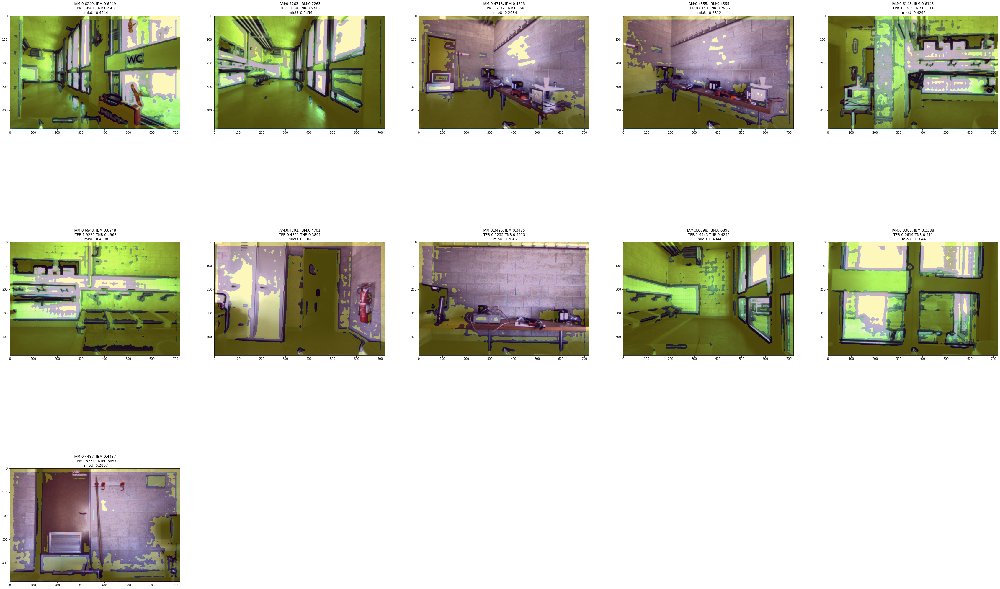

In [5]:
scoreAndPlotPredictions(lambda img:tf.keras.utils.to_categorical(tf.cast(net.signatures['serving_default'](img)['min_nll'] > 150, tf.int32), num_classes=2, dtype='float32' ), dataLoaderArche)

Accuracy on validation set: 0.6153675
mIoU on validation set: 0.41521487
Balanced Accuracy on validation set: 0.58131933
Positive = Foreground, Negative = Background
TPR on validation set: 0.70556
TNR on validation set: 0.44383606
Precision  on validation set: 0.70697725


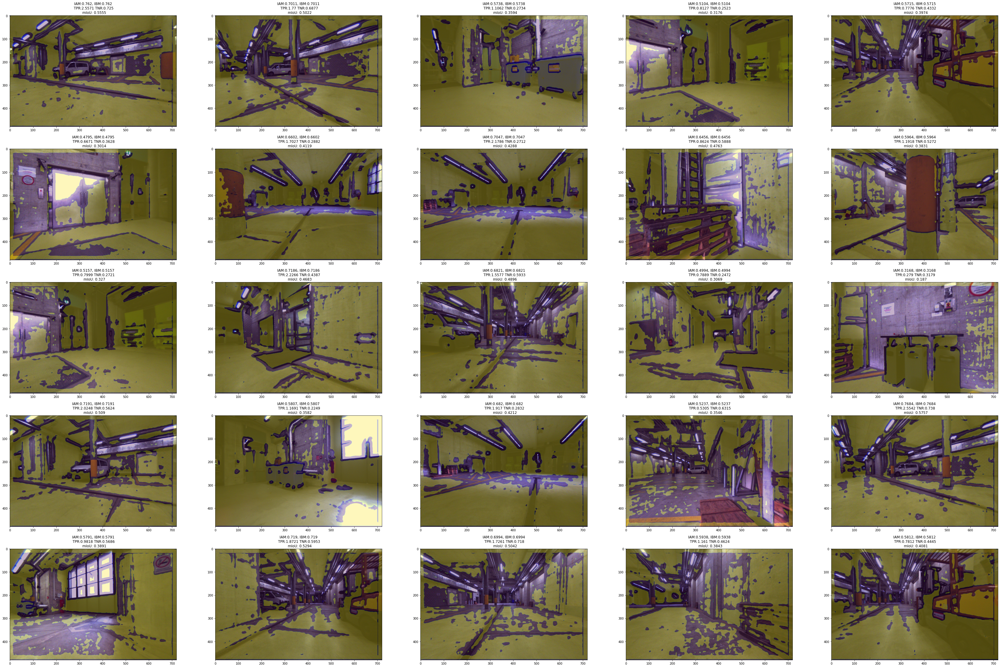

In [8]:
scoreAndPlotPredictions(lambda img:tf.keras.utils.to_categorical(tf.cast(net.signatures['serving_default'](img)['min_nll'] > 150, tf.int32), num_classes=2, dtype='float32' ), dataLoaderCLA)

# NYU Model Pretrained 30 Epochs

In [11]:
## Pretrained NYU model for 10 epochs

model_weights = '../src/baseline_model.h5'
BACKBONE = "vgg16"
model = sm.PSPNet(BACKBONE, input_shape=(image_h, image_w, 3), classes=2)

model.compile(
    loss=ignorant_cross_entropy_loss,
    optimizer=tf.keras.optimizers.Adam(0.001),
    metrics=['accuracy']
)

model.load_weights(model_weights)

/home/rene/tf_venv/lib/python3.6/site-packages/ipykernel_launcher.py:49: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


Accuracy on validation set: 0.45853955
mIoU on validation set: 0.28572184
Balanced Accuracy on validation set: 0.52559197
Positive = Foreground, Negative = Background
TPR on validation set: 0.21224515
TNR on validation set: 0.8511165
Precision  on validation set: 0.6944025


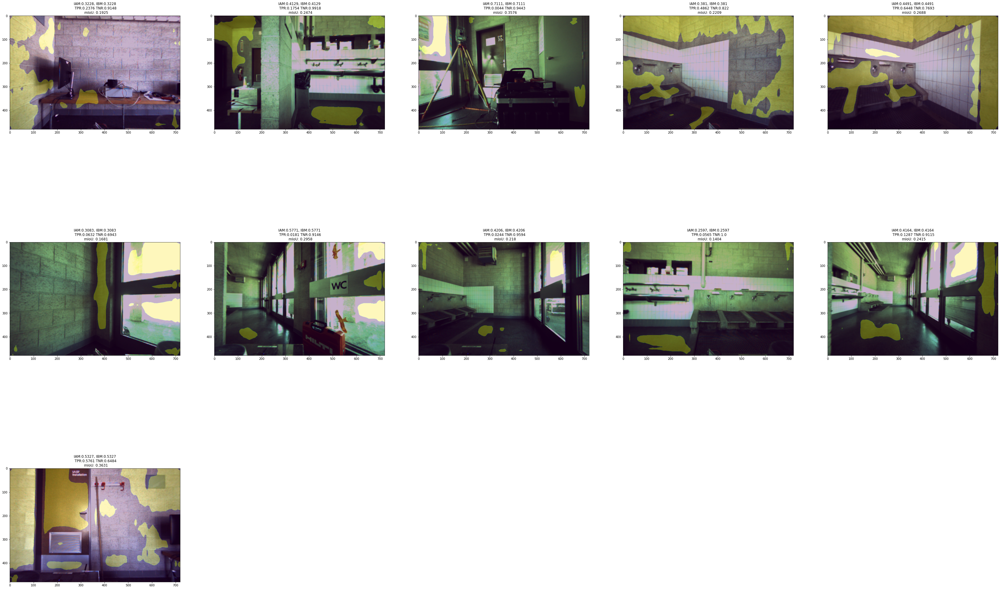

In [10]:
scoreAndPlotPredictions(lambda img: model.predict(img), dataLoaderArche) 

Accuracy on validation set: 0.8060227
mIoU on validation set: 0.66003764
Balanced Accuracy on validation set: 0.7997663
Positive = Foreground, Negative = Background
TPR on validation set: 0.8163693
TNR on validation set: 0.78702104
Precision  on validation set: 0.8756146


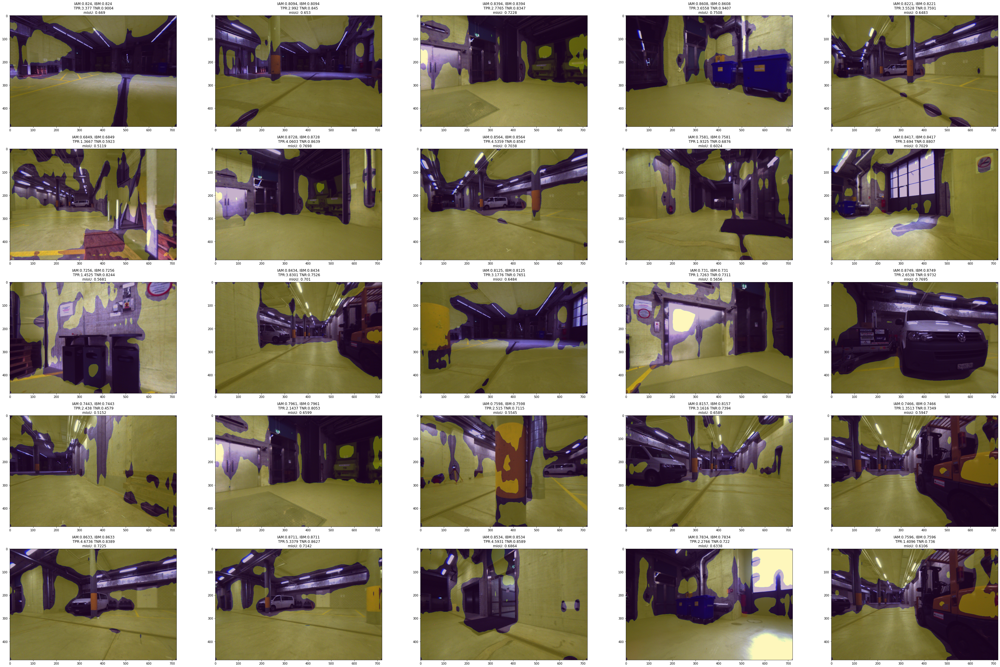

In [12]:
scoreAndPLotPredictions(lambda img: model.predict(img), dataLoaderCLA)